Working with the Lakh dataset
https://www.kaggle.com/datasets/imsparsh/lakh-midi-clean/

In [19]:
import pretty_midi
import os
import matplotlib.pyplot as plt

In [2]:
def create_dataset(base_path):
    """
    Load the data from the base_path and create a dataset.
    Args:
    base_path: (str) The path to the base folder containing the data.

    Returns:
    dict: A dictionary with the artist names as keys and a list of all midi file paths as values.
    """
    midi_files = {}
    for root, dirs, files in os.walk(base_path):
        for file in files:
            if file.endswith('.mid') or file.endswith('.midi'):
                artist = os.path.basename(root)
                if artist not in midi_files:
                    midi_files[artist] = []
                midi_files[artist].append(os.path.join(root, file))
    return midi_files

In [3]:
midi_dataset = create_dataset('./lakh')
midi_dataset

{'VOF_de_Kunst': ['./lakh/VOF_de_Kunst/Een_kopje_koffie.mid'],
 'Eubie_Blake': ['./lakh/Eubie_Blake/Charleston_Rag.mid',
  './lakh/Eubie_Blake/Chevy_Chase.mid'],
 'Wilson,Jackie': ['./lakh/Wilson,Jackie/I_Get_the_Sweetest_Feeling.mid',
  './lakh/Wilson,Jackie/Your_Love_Keeps_Lifting_Me_Higher_Higher.mid'],
 'The_Escape_Club': ['./lakh/The_Escape_Club/Shake_for_the_Sheik.mid'],
 'Morricone_Ennio': ['./lakh/Morricone_Ennio/Luomo_Dellarmonica.4.mid',
  './lakh/Morricone_Ennio/The_Good,_the_Bad_The_Ugly.mid',
  './lakh/Morricone_Ennio/Luomo_Dellarmonica.2.mid',
  './lakh/Morricone_Ennio/Luomo_Dellarmonica.3.mid',
  './lakh/Morricone_Ennio/Luomo_Dellarmonica.1.mid',
  './lakh/Morricone_Ennio/Luomo_Dellarmonica.mid'],
 'Honey_Cone': ['./lakh/Honey_Cone/Want_Ads.mid'],
 'The_Four_Aces': ['./lakh/The_Four_Aces/The_Gang_That_Sang_Heart_of_My_Heart.mid'],
 'Vaughn': ['./lakh/Vaughn/Greensleeves.mid',
  './lakh/Vaughn/Petite_Fleur.mid',
  './lakh/Vaughn/Isle_of_Capri.mid',
  './lakh/Vaughn/Blue_T

In [37]:
# Check the number of midi files
file_count = 0
for artist, files in midi_dataset.items():
    for file in files:
        file_count += 1

print(f'We have {file_count} midi songs')

We have 17232 midi songs


In [4]:
import IPython.display as ipd

def play_midi(midi_file):
    # Load the MIDI file
    midi_data = pretty_midi.PrettyMIDI(midi_file)

    # Synthesize audio from MIDI
    audio_data = midi_data.synthesize()

    # Play the audio
    ipd.display(ipd.Audio(audio_data, rate=44100))

In [14]:
midi_file_path = './lakh/ABBA/S.O.S.mid'
play_midi(midi_dataset['VOF_de_Kunst'][0])

In [11]:
def list_instruments(midi_file):
    # Load the MIDI file
    midi_data = pretty_midi.PrettyMIDI(midi_file)    
    instruments = midi_data.instruments
    intrument_names = [instrument.name for instrument in instruments]
    return intrument_names

In [13]:
midi_file_path1 = './lakh/VOF_de_Kunst/Een_kopje_koffie.mid'
list_instruments(midi_file_path1)

['#Elctr.Bd',
 '#Dance Sn',
 '#Tmbourin',
 '#Crsh.Cmb',
 '#Crsh.Cmb',
 '#CM OHH 1',
 '#CM OHH 2',
 '#CM CHH  ',
 '#Low Tom ',
 '#Low Tom ',
 '#Mid Tom ',
 '#Mid Tom ',
 '#Hgh.Tom ',
 '#Hgh.Tom ',
 '#A.Piano ',
 'Fing.Bass',
 'Brass Sec',
 'Vocal-Lin',
 '#Rtr.Orga',
 '#Mtd.Gtr.',
 '#Chrs.Gtr',
 '#Chrs.Gtr',
 'Dist.Gtr.',
 'Gt.Hrmncs']

In [15]:
cnt = 0
done = False
for artist, midi_files in midi_dataset.items():
    for midi_file in midi_files:
        instruments = list_instruments(midi_file)
        print(artist, midi_file, instruments)
        cnt += 1
        if cnt == 10:
            done = True
            break
    if done:
        break


VOF_de_Kunst ./lakh/VOF_de_Kunst/Een_kopje_koffie.mid ['#Elctr.Bd', '#Dance Sn', '#Tmbourin', '#Crsh.Cmb', '#Crsh.Cmb', '#CM OHH 1', '#CM OHH 2', '#CM CHH  ', '#Low Tom ', '#Low Tom ', '#Mid Tom ', '#Mid Tom ', '#Hgh.Tom ', '#Hgh.Tom ', '#A.Piano ', 'Fing.Bass', 'Brass Sec', 'Vocal-Lin', '#Rtr.Orga', '#Mtd.Gtr.', '#Chrs.Gtr', '#Chrs.Gtr', 'Dist.Gtr.', 'Gt.Hrmncs']
Eubie_Blake ./lakh/Eubie_Blake/Charleston_Rag.mid ['A.PIANO 1']
Eubie_Blake ./lakh/Eubie_Blake/Chevy_Chase.mid ['A.PIANO 1']
Wilson,Jackie ./lakh/Wilson,Jackie/I_Get_the_Sweetest_Feeling.mid ['0607SWET', '0607SWET', '0607SWET', '0607SWET', '0607SWET', '0607SWET', '0607SWET', '0607SWET', '0607SWET', '0607SWET']
Wilson,Jackie ./lakh/Wilson,Jackie/Your_Love_Keeps_Lifting_Me_Higher_Higher.mid ['0077HIGH', '0077HIGH', '0077HIGH', '0077HIGH', '0077HIGH', '0077HIGH', '0077HIGH', '0077HIGH', '0077HIGH', '0077HIGH', '0077HIGH']
The_Escape_Club ./lakh/The_Escape_Club/Shake_for_the_Sheik.mid ['MUTED GTR', 'E.PIANO 2', 'ORGAN 3', 'STEEL 

/Users/javv/code/iths/venv/lib/python3.11/site-packages/pretty_midi/pretty_midi.py:100: RuntimeWarning: Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.
  warnings.warn(


Create a piano roll

In [24]:
def create_piano_roll(midi_file, instrument_name=None, start_time=None, end_time=None):
    midi_data = pretty_midi.PrettyMIDI(midi_file)

    # If no instrument is provided we will use the first instrument
    if instrument_name is None:
        instrument = midi_data.instruments[0]
    else:
        # Find the instrument by name
        instrument = next((inst for inst in midi_data.instruments if inst.name == instrument_name), None)
        if instrument is None:
            return None
    
    # Create the piano roll matrix
    fs = 100  # Sampling frequencey for the piano roll
   
    piano_roll = instrument.get_piano_roll(fs=fs)

    if start_time is not None:
        start_frame = int(start_time * fs)
    else:
        start_frame = 0

    if end_time is not None:
        end_frame = int(end_time * fs)
    else:
        end_frame = piano_roll.shape[1]

    piano_roll = piano_roll[:, start_frame:end_frame]

    fig, ax = plt.subplots(figsize=(8, 4))
    ax.imshow(piano_roll, aspect='auto', interpolation='nearest', cmap='gray_r')
    ax.invert_yaxis()  # Invert the y-axis to display the piano roll correctly
    ax.set_title(f'Piano Roll for {instrument_name or instrument.name}')
    ax.set_xlabel('Time (in frames)')
    ax.set_ylabel('Pitch')

    return fig

/var/folders/sv/smp88v5n4n330qyj6d8gm4lh0000gn/T/ipykernel_85470/3367611887.py:2: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


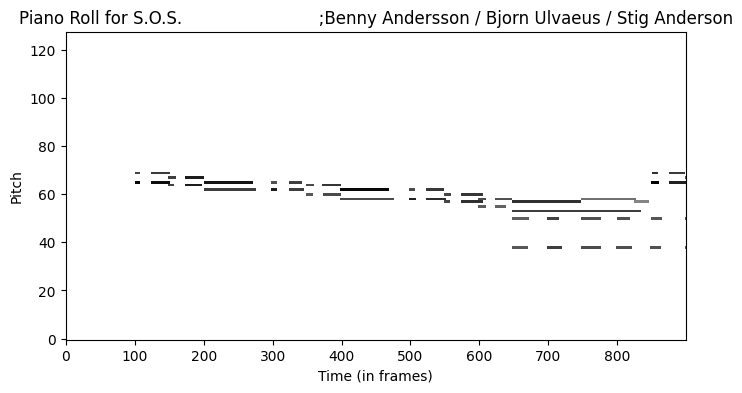

In [25]:
fig = create_piano_roll(midi_file_path, start_time=1, end_time=10)
fig.show()

## Extracting the Melody
We will have a simple approach to try to extract the melody. We will look at the highest note played at each time step and assume that it is the melody. This is a reasonable assumption for many types of music, especially in Western music, where the melody is often carried by the highest-pitched notes. However, this assumption does not hold for all types of music.


### Pros of the Assumption:
1. **Simplicity**: This method provides a straightforward way to identify the melody without complex analysis.
2. **Common in Many Genres**: In many musical genres, especially in Western music, the melody is often carried by the highest-pitched notes, making this a reasonable starting point.

### Cons and Limitations:
1. **Not Always True**: The assumption does not hold for all types of music. In many compositions, the melody may be in the middle register or even lower, played by different instruments.
2. **Complex Compositions**: In complex musical pieces with multiple instruments, the melody can shift between instruments, and not all of them may have the highest pitch at all times.
3. **Harmonic and Rhythmic Elements**: The approach overlooks other important elements like harmony and rhythm, which are crucial in understanding and generating music.
4. **Subjectivity in Music**: Melody identification can be subjective, and different listeners might identify different parts as the melodic line in the same piece of music.

### Alternatives and Enhancements:
- **Machine Learning Models**: More advanced models can be trained to identify melodies, considering various musical elements.
- **Rule-Based Approaches**: Implementing more complex rules that consider rhythm, harmony, and instrument timbre.
- **Manual Annotation**: For a small dataset, manual annotation of the melody line by a musician could be more accurate.

In summary, while using the highest notes as a proxy for the melody is a fair starting point for many applications, especially when dealing with large datasets or lacking in-depth musical analysis tools, it's not a one-size-fits-all solution. The suitability of this assumption largely depends on the type of music you are working with and the goals of your project.

In [26]:
def extract_melody(midi_file, instrument_name=None):
    midi_data = pretty_midi.PrettyMIDI(midi_file)

    if instrument_name is not None:
        melody_instrument = next((inst for inst in midi_data.instruments if inst.name == instrument_name), None)
        if melody_instrument is None:
            return None
    else:
        # No instrument provided. We will find the instrument with the highest everage note
        max_avg_pith = -1
        melody_instrument = None

        for instrument in midi_data.instruments:
            if not instrument.is_drum:
                avg_pitch = sum(note.pitch for note in instrument.notes) / len(instrument.notes)
                if avg_pitch > max_avg_pith:
                    max_avg_pith = avg_pitch
                    melody_instrument = instrument
    melody = [(note.start, note.end, note.pitch) for note in melody_instrument.notes]
    return melody, melody_instrument.name

In [31]:
midi_file = './lakh/ABBA/S.O.S.mid'
melody, instrument_name = extract_melody(midi_file)
instrument_name

'S.O.S.                          ;Benny Andersson / Bjorn Ulvaeus / Stig Anderson'

In [32]:
melody

[(7.494791666666666, 8.041666666666666, 57),
 (8.0, 8.260416666666666, 65),
 (8.255208333333332, 8.53125, 57),
 (8.5, 8.770833333333332, 58),
 (8.744791666666666, 9.026041666666666, 65),
 (8.994791666666666, 9.28125, 58),
 (9.255208333333332, 11.536458333333332, 57),
 (14.994791666666666, 15.515625, 57),
 (15.494791666666666, 15.796875, 65),
 (15.744791666666666, 16.036458333333332, 57),
 (15.994791666666666, 16.260416666666664, 58),
 (16.244791666666664, 16.53125, 65),
 (16.494791666666664, 16.770833333333332, 58),
 (16.75, 17.984375, 57),
 (40.994791666666664, 41.11458333333333, 77),
 (41.11458333333333, 41.23958333333333, 69),
 (41.23958333333333, 41.34375, 74),
 (41.36458333333333, 41.48958333333333, 77),
 (41.48958333333333, 41.61458333333333, 79),
 (41.61458333333333, 41.734375, 73),
 (41.734375, 41.86458333333333, 76),
 (41.86458333333333, 41.98958333333333, 79),
 (41.98958333333333, 42.109375, 81),
 (42.109375, 42.23958333333333, 74),
 (42.23958333333333, 42.36458333333333, 77)

In [33]:
def play_melody(melody):
    midi = pretty_midi.PrettyMIDI()
    instrument = pretty_midi.Instrument(program=41)

    # Add notes
    for start, end, pitch in melody:
        note = pretty_midi.Note(velocity=100, pitch=pitch, start=start, end=end)
        instrument.notes.append(note)
    
    midi.instruments.append(instrument)

    # Synthesize audio from MIDI
    audio_data = midi.synthesize()

    # Play the audio
    ipd.display(ipd.Audio(audio_data, rate=44100))

In [34]:
play_melody(melody)

After processing your MIDI dataset with the provided function, `X` and `y` are arrays prepared for training a machine learning model, specifically an LSTM model in your case. Here's a bit more detail about what each of these variables represents:

### X - Input Sequences
- **Structure**: `X` is a 3-dimensional NumPy array where each entry represents a one-hot encoded sequence of notes.
- **Dimensions**: The shape of `X` is `(number_of_sequences, sequence_length, num_unique_notes)`.
  - **number_of_sequences**: The total number of sequences extracted from all the MIDI files.
  - **sequence_length**: The fixed length of each input sequence (as defined in your function). In your example, it's 10.
  - **num_unique_notes**: The number of unique MIDI notes (128 in standard MIDI). Each note in a sequence is represented as a one-hot encoded vector of this length.
- **Content**: Each sequence in `X` is a series of vectors, where each vector represents a note in one-hot encoded form. A one-hot vector for a note is all zeros except for a 1 at the index corresponding to the note's MIDI number.

### y - Output Sequences
- **Structure**: `y` is a 2-dimensional NumPy array where each entry is a one-hot encoded vector representing the next note in the sequence.
- **Dimensions**: The shape of `y` is `(number_of_sequences, num_unique_notes)`.
- **Content**: Each entry in `y` corresponds to the next note that follows a sequence in `X`, represented as a one-hot encoded vector. For example, if `X[i]` is a sequence of notes, `y[i]` is the one-hot encoded representation of the note that comes after this sequence in the original melody.

### Purpose in Machine Learning
- The idea is to train your LSTM model to predict the next note (`y`) given a sequence of previous notes (`X`). During training, the model learns the patterns in these sequences so that when you provide a new sequence of notes (not necessarily from your training data), the model can predict the next note, allowing for music generation.

### Example
If your sequence length is 10 and MIDI note range is 128, `X` might look like this (simplified for explanation):

```plaintext
[
    [[1, 0, 0, ..., 0], [0, 1, 0, ..., 0], ..., [0, 0, 0, ..., 1]],  # First sequence
    [[0, 1, 0, ..., 0], [0, 0, 1, ..., 0], ..., [1, 0, 0, ..., 0]],  # Second sequence
    ...
]
```

And `y` would be:

```plaintext
[
    [0, 1, 0, ..., 0],  # Next note for the first sequence
    [0, 0, 1, ..., 0],  # Next note for the second sequence
    ...
]
```

Each inner array in `X` represents a note, with the position of the '1' indicating the note's MIDI number. Each entry in `y` is the next note in the sequence. The model's task is to predict the '1' position in `y` given the arrays in `X`.

In [38]:
from tensorflow.keras.utils import to_categorical
import numpy as np

def process_midi_datasset(midi_dataset, sequence_lenght=10, num_unique_notes=128):
    input_sequence = []
    next_notes = []
    cnt = 0
    for _, files in midi_dataset.items():
        for file_path in files: 
            cnt += 1
            print(f'File {cnt} of 17232')
            try:
                melody = extract_melody(file_path)
                pitches = [note[2] for note in melody]

                for i in range(len(pitches)- sequence_lenght):
                    seq_in = pitches[i:i + sequence_lenght]
                    seq_out = [i + sequence_lenght]
                    input_sequence.append(seq_in)
                    next_notes.append(seq_out)
            except Exception as e:
                print(f'Error: {str(e)}')
                print(f'Skipping {file_path}')

    X = np.array([to_categorical(seq, num_classes=num_unique_notes) for seq in input_sequence])
    y = to_categorical(next_notes, num_classes=num_unique_notes)

    return X, y


In [39]:
import pickle


sequence_length = 10
X, y = process_midi_datasset(midi_dataset)

with open('midi_dataset_X.pkl', 'wb') as file:
    pickle.dump(X, file)

with open('midi_dataset_y.pkl', 'wb') as file:
    pickle.dump(y, file)

File 1 of 17232
File 2 of 17232
File 3 of 17232
File 4 of 17232
File 5 of 17232
File 6 of 17232
File 7 of 17232
Error: string index out of range
Skipping ./lakh/Morricone_Ennio/Luomo_Dellarmonica.4.mid
File 8 of 17232
File 9 of 17232


/Users/javv/code/iths/venv/lib/python3.11/site-packages/pretty_midi/pretty_midi.py:100: RuntimeWarning: Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.
  warnings.warn(


Error: string index out of range
Skipping ./lakh/Morricone_Ennio/Luomo_Dellarmonica.2.mid
File 10 of 17232
File 11 of 17232
File 12 of 17232
File 13 of 17232
File 14 of 17232
File 15 of 17232
File 16 of 17232
Error: list index out of range
Skipping ./lakh/Vaughn/Petite_Fleur.mid
File 17 of 17232
File 18 of 17232
File 19 of 17232
Error: string index out of range
Skipping ./lakh/Cocciante/Io_canto.mid
File 20 of 17232
File 21 of 17232
File 22 of 17232
Error: string index out of range
Skipping ./lakh/Cocciante/Se_stiamo_insieme.mid
File 23 of 17232
File 24 of 17232
Error: string index out of range
Skipping ./lakh/Cocciante/Bella_senzanima.mid
File 25 of 17232
File 26 of 17232
Error: string index out of range
Skipping ./lakh/Cocciante/Se_stiamo_insieme.2.mid
File 27 of 17232
Error: string index out of range
Skipping ./lakh/Cocciante/Se_stiamo_insieme.3.mid
File 28 of 17232
Error: string index out of range
Skipping ./lakh/Cocciante/In_bicicletta.mid
File 29 of 17232
File 30 of 17232
Error: 

In [ ]:
# Load X and y from the file
with open('midi_dataset_X.pkl', 'rb') as file:
    X = pickle.load(file)

with open('midi_dataset_y.pkl', 'rb') as file:
    y = pickle.load(file)